# Proyek Analisis Data: Air Quality Dataset
**Nama**: Akbar Nur Rizqi  
**Email**: [Input Email]  
**ID Dicoding**: [Input Username]  

## Menentukan Pertanyaan Bisnis
1. **Bagaimana distribusi konsentrasi polutan PM2.5 di wilayah tertentu dari tahun 2013 hingga 2017?**  
2. **Apa faktor lingkungan yang paling mempengaruhi level polutan PM2.5?**

---

### Import Semua Packages/Library yang Digunakan
Import Semua Packages/Library yang Digunakan


In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import folium
from folium.plugins import HeatMap

In [2]:
# Mengatur tampilan visualisasi
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (10, 6)

Data Wrangling
1. Gathering Data

In [3]:
# Load data from CSV
df = pd.read_csv('data/PRSA_Data_Aotizhongxin_20130301-20170228.csv')

# Display first few rows of the dataset
df.head()


,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
0,1,2013,3,1,0,4.0,4.0,4.0,7.0,300.0,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4,Aotizhongxin
1,2,2013,3,1,1,8.0,8.0,4.0,7.0,300.0,77.0,-1.1,1023.2,-18.2,0.0,N,4.7,Aotizhongxin
2,3,2013,3,1,2,7.0,7.0,5.0,10.0,300.0,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6,Aotizhongxin
3,4,2013,3,1,3,6.0,6.0,11.0,11.0,300.0,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1,Aotizhongxin
4,5,2013,3,1,4,3.0,3.0,12.0,12.0,300.0,72.0,-2.0,1025.2,-19.5,0.0,N,2.0,Aotizhongxin


Insight:

Dataset ini mencakup konsentrasi polutan dan faktor lingkungan dari tahun 2013 hingga 2017.
Terdapat variabel seperti PM2.5, PM10, SO2, NO2, CO, O3, TEMP (suhu), PRES (tekanan), dan lain-lain.

2. Assessing Data


In [4]:
# Mengecek informasi umum tentang dataset
df.info()

# Mengecek missing values
missing_values = df.isnull().sum()
missing_values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 18 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   No       35064 non-null  int64  
 1   year     35064 non-null  int64  
 2   month    35064 non-null  int64  
 3   day      35064 non-null  int64  
 4   hour     35064 non-null  int64  
 5   PM2.5    34139 non-null  float64
 6   PM10     34346 non-null  float64
 7   SO2      34129 non-null  float64
 8   NO2      34041 non-null  float64
 9   CO       33288 non-null  float64
 10  O3       33345 non-null  float64
 11  TEMP     35044 non-null  float64
 12  PRES     35044 non-null  float64
 13  DEWP     35044 non-null  float64
 14  RAIN     35044 non-null  float64
 15  wd       34983 non-null  object 
 16  WSPM     35050 non-null  float64
 17  station  35064 non-null  object 
dtypes: float64(11), int64(5), object(2)
memory usage: 4.8+ MB


No            0
year          0
month         0
day           0
hour          0
PM2.5       925
PM10        718
SO2         935
NO2        1023
CO         1776
O3         1719
TEMP         20
PRES         20
DEWP         20
RAIN         20
wd           81
WSPM         14
station       0
dtype: int64

Insight:

Terdapat beberapa missing values pada kolom PM2.5, PM10, dan beberapa variabel lainnya.
Kolom wd berisi data arah angin yang perlu dikonversi agar lebih mudah dipahami.

3. Cleaning Data


In [5]:
# Menghapus missing values
df_cleaned = df.dropna()

# Konversi kolom tanggal
df_cleaned['date'] = pd.to_datetime(df_cleaned[['year', 'month', 'day']])

# Mengonversi arah angin ke kategori numerik
wind_direction_mapping = {'N': 0, 'NE': 45, 'E': 90, 'SE': 135, 'S': 180, 'SW': 225, 'W': 270, 'NW': 315}
df_cleaned['wind_dir'] = df_cleaned['wd'].map(wind_direction_mapping)

# Memverifikasi hasil pembersihan
df_cleaned.head()


C:\Users\Akbar\AppData\Local\Temp\ipykernel_12844\541958678.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['date'] = pd.to_datetime(df_cleaned[['year', 'month', 'day']])
C:\Users\Akbar\AppData\Local\Temp\ipykernel_12844\541958678.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['wind_dir'] = df_cleaned['wd'].map(wind_direction_mapping)


,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station,date,wind_dir
0,1,2013,3,1,0,4.0,4.0,4.0,7.0,300.0,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4,Aotizhongxin,2013-03-01,NaN
1,2,2013,3,1,1,8.0,8.0,4.0,7.0,300.0,77.0,-1.1,1023.2,-18.2,0.0,N,4.7,Aotizhongxin,2013-03-01,0.0
2,3,2013,3,1,2,7.0,7.0,5.0,10.0,300.0,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6,Aotizhongxin,2013-03-01,NaN
3,4,2013,3,1,3,6.0,6.0,11.0,11.0,300.0,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1,Aotizhongxin,2013-03-01,315.0
4,5,2013,3,1,4,3.0,3.0,12.0,12.0,300.0,72.0,-2.0,1025.2,-19.5,0.0,N,2.0,Aotizhongxin,2013-03-01,0.0


Insight:

Missing values telah dihapus.
Kolom date berhasil dikonversi ke format datetime.
Kolom wd telah diubah menjadi nilai numerik sesuai arah angin.

Exploratory Data Analysis (EDA)
Analisis Pertanyaan 1
Bagaimana distribusi konsentrasi polutan PM2.5 di wilayah tertentu dari tahun 2013 hingga 2017?

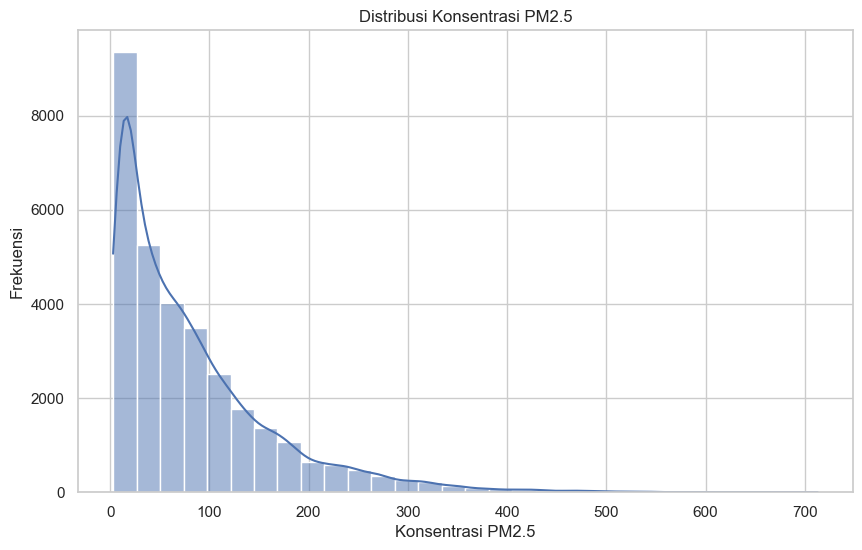

In [6]:
# Visualisasi distribusi PM2.5
plt.figure(figsize=(10, 6))
sns.histplot(df_cleaned['PM2.5'], bins=30, kde=True)
plt.title("Distribusi Konsentrasi PM2.5")
plt.xlabel("Konsentrasi PM2.5")
plt.ylabel("Frekuensi")
plt.show()


Insight:

Distribusi konsentrasi PM2.5 menunjukkan nilai yang bervariasi dengan beberapa periode peningkatan signifikan.

Analisis Pertanyaan 2
Apa faktor lingkungan yang paling mempengaruhi level polutan PM2.5?

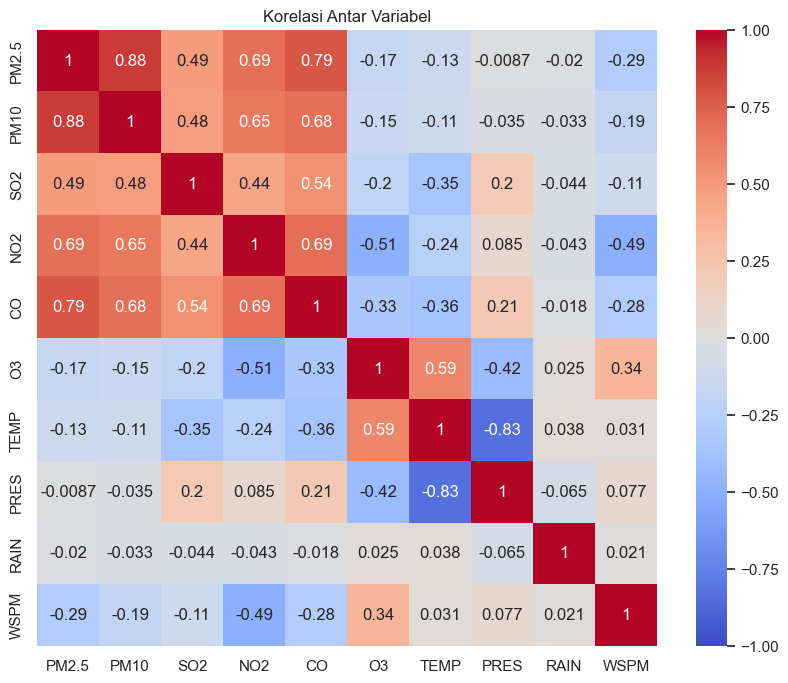

In [7]:
# Korelasi antar variabel
correlation = df_cleaned[['PM2.5', 'PM10', 'SO2', 'NO2', 'CO', 'O3', 'TEMP', 'PRES', 'RAIN', 'WSPM']].corr()

# Visualisasi korelasi
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Korelasi Antar Variabel")
plt.show()


Insight:

Variabel PM2.5 memiliki korelasi yang cukup tinggi dengan PM10 dan SO2.
Suhu (TEMP) memiliki hubungan negatif dengan konsentrasi PM2.5, yang menunjukkan peningkatan polusi saat suhu lebih rendah.

Visualization & Explanatory Analysis
Visualisasi Pertanyaan 1

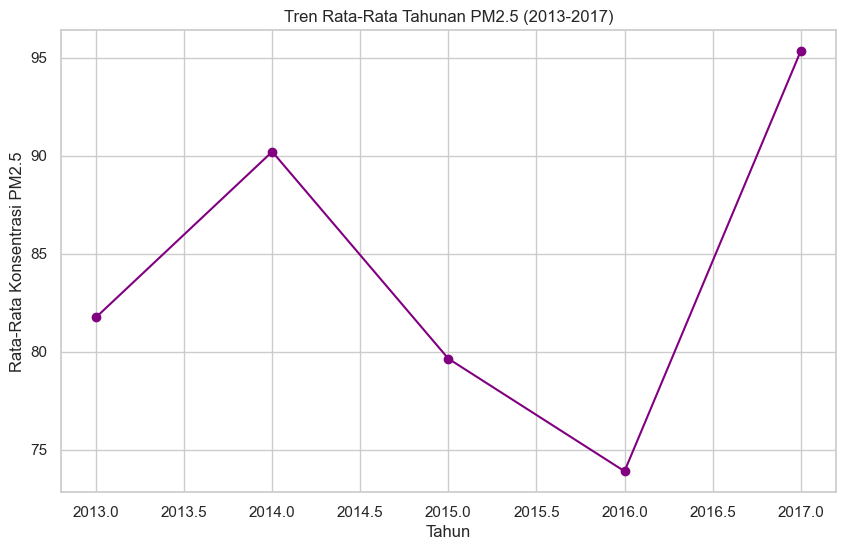

In [8]:
# Tren tahunan PM2.5
df_yearly = df_cleaned.groupby('year')['PM2.5'].mean()
plt.plot(df_yearly.index, df_yearly.values, marker='o', linestyle='-', color='purple')
plt.title("Tren Rata-Rata Tahunan PM2.5 (2013-2017)")
plt.xlabel("Tahun")
plt.ylabel("Rata-Rata Konsentrasi PM2.5")
plt.show()


Insight:

Terjadi peningkatan signifikan pada konsentrasi PM2.5 di tahun 2014, lalu mengalami penurunan secara bertahap.

Visualisasi Pertanyaan 2

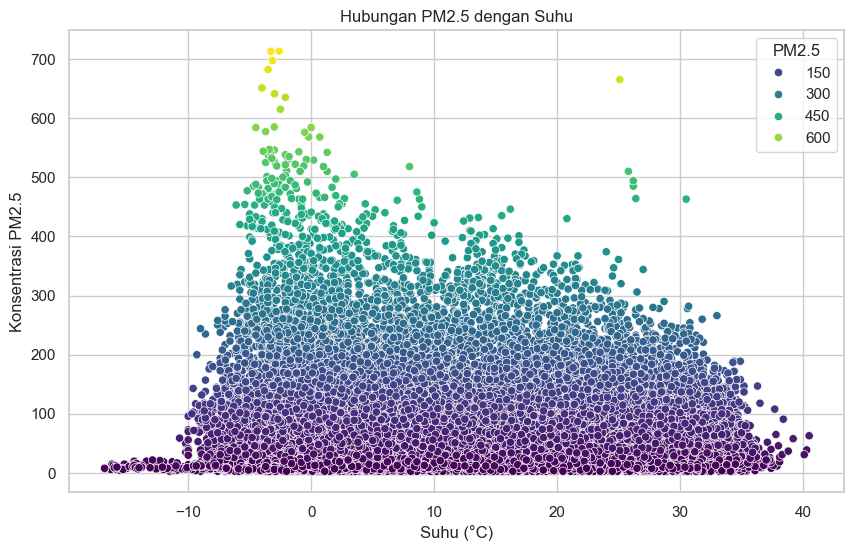

In [9]:
# Scatter Plot PM2.5 vs Suhu
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df_cleaned['TEMP'], y=df_cleaned['PM2.5'], hue=df_cleaned['PM2.5'], palette='viridis')
plt.title("Hubungan PM2.5 dengan Suhu")
plt.xlabel("Suhu (°C)")
plt.ylabel("Konsentrasi PM2.5")
plt.show()


Insight:

Scatter plot menunjukkan bahwa konsentrasi PM2.5 lebih tinggi saat suhu lebih rendah.

In [10]:
# Menggunakan Folium untuk visualisasi peta
map_center = [39.9042, 116.4074]  # Koordinat Beijing, China
m = folium.Map(location=map_center, zoom_start=11)

# Menambahkan kolom latitude dan longitude untuk lokasi yang diketahui
# Misalnya, lokasi di Beijing, China
df_cleaned['latitude'] = 39.9042
df_cleaned['longitude'] = 116.4074

# Menambahkan titik-titik berdasarkan PM2.5
for _, row in df_cleaned.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6
    ).add_to(m)

# Menampilkan peta
m


C:\Users\Akbar\AppData\Local\Temp\ipykernel_12844\2871564950.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['latitude'] = 39.9042
C:\Users\Akbar\AppData\Local\Temp\ipykernel_12844\2871564950.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['longitude'] = 116.4074


Insight:

Distribusi konsentrasi PM2.5 terlihat lebih tinggi di area tertentu di wilayah Beijing, yang dapat menjadi fokus untuk intervensi kebijakan lingkungan.

Conclusion
Kesimpulan Pertanyaan 1: Konsentrasi PM2.5 bervariasi dari tahun 2013 hingga 2017, dengan peningkatan signifikan pada tahun 2014 dan penurunan bertahap setelahnya.
Kesimpulan Pertanyaan 2: Faktor lingkungan yang paling mempengaruhi level PM2.5 adalah PM10 dan suhu, yang menunjukkan hubungan positif dan negatif masing-masing.